# Model of coupled englacial and subglacial drainage model

This is a model that assumes the glacier has a porosity and that water is stored in the glacier, as if it is an aquifer. The water ptable in the aquifer goes up and down in response to the flow of a subglacial drainage system and input from the surface. 

ToDo: add model equations here. 

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm
import plotly.express as px
import time

In [2]:
# physical constants
g = 9.8
L = 3.3e5
rho_w =1000
rho_i = 900
K = 1e-24
beta = 1000

# geometry
H = 500      # ice thickness
sigma = 0.01 # surface slope

# you have to choose a timescale
t0 = 60*60;   # 1 hour

# scales dependent on geometry
psi0 = rho_w*g*sigma;    # hydraulic gradient [Pa/m]   constant
x0 = 10000;    # length of channel [m]   constant
phi0 = 0.01;   # porosity of the glacier [dimensionless] a constant, but could be a variable in future versions
tau0 = rho_w*g*H*sigma  # basal shear stress [Pa]

# scales dependent on climate
Q0 = 10;    # discharge [m^3/s], variable of the model

# scales that depend on other scales
M0 = Q0/x0;             # melt at surface and bed [m^2/s],input to the model
N0 = psi0*x0            # effective pressue [Pa], variable of the model
m0 = Q0*psi0/L          # melt rate along the channel walls [kg/s/m/s], variable of the model
S0 = m0/(rho_i*N0**3*K)  # channel cross-sectional area [m^2], variable of the model

# non-dimensional parameters
nu = S0*rho_i/t0/m0               # channel area evolution constant
lam = N0*phi0/t0/rho_w/g/M0    # storage term evolution constant
delta = 1/phi0                    # porosity scale parameter
alpha = N0*x0/t0/tau0             # porosity evolution parameter

ratio = rho_w*g*Q0/K/psi0**4/x0**5/phi0   # nu/lamda first worked out analyticall
nu/lam;

def N2head(N): 
    return (rho_i*g*H - N)/(rho_w*g);

In [3]:
#lam = 0.2777
#nu = 1


100%|██████████| 250000/250000 [00:07<00:00, 33635.64it/s]


code took 7.5128 seconds


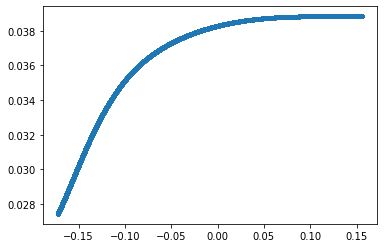

100.0


In [4]:

tic = time.perf_counter()
## space domain
dx_temp = 0.04 
X=1.0
Nsteps = np.round(X/(dx_temp)+1)
x = np.linspace(0, X, int(Nsteps))
Lx = len(x)
dx = x[1] - x[0]
x_stag = (x[1:]+x[:-1])/2
HalfLx = int(np.round(Lx/2)-1)

## time domain
dt_temp = 0.00040
T=100;
Nsteps = np.round(T/(dt_temp)+1)
t = np.linspace(0, T, int(Nsteps))
Lt = len(t)
dt = t[1] - t[0]
HalfLt = int(np.round(Lt/2)-1)

## psi     - basic hydraulic gradient
psi = 1

## S    - channel cross-sectional area
S = x_stag*0 + 0.1   

## M   - background supply of meltwater from the surface or the bed
M = 0.1

## BCs

Ntop = 0.3 #+ t*0+0.05*np.sin(2*np.pi*t*t0/2000);
Nbottom = 0

## initial condition
# a random profile that obeys the boundary conditions. 
N = Ntop + x*(Nbottom-Ntop)/X #+ 0.2*np.sin(x*np.pi);


PSI = (psi + (N[1:] - N[:-1])/dx)   # on the stag grid
Q = np.sign(PSI)*np.sqrt(S**(8/3)*np.abs(PSI))    # on the stag grid


## phi   - porosity of the glacier (non-dimensional, but phi0 = 1)
phi = 5

## pre-allocate output arrays
Qout = t*np.nan
Sout = t*np.nan
Nout = t*np.nan
    
Qout[0] = Q[HalfLx]
Sout[0] = S[HalfLx]
Nout[0] = N[HalfLx]

for ii in tqdm(range(1, Lt)):    
    
    N_old = N
    Q_old = Q
    # update N
    N[1:-1] = N[1:-1] + dt/lam*( (Q[1:] - Q[:-1])/dx  -  M)/phi  # on the main grid
    #N[0] = Ntop[ii]
    
    #N_stag = (N[1:] + N[:-1])/2    # on the stag grid    
    # update S
    #S = S + dt/nu*(np.abs(Q_old)**3 - S*N_stag**3)    # on the stag grid  
    
    PSI = (psi + (N[1:] - N[:-1])/dx)   # on the staggered grid    
    Q = np.sign(PSI)*np.sqrt(S**(8/3)*np.abs(PSI))  # Q on the staggered grid
    
    Qout[ii] = Q[HalfLx]
    Sout[ii] = S[HalfLx]
    Nout[ii] = N[HalfLx]
   

toc = time.perf_counter()

print(f"code took {toc - tic:0.4f} seconds")
plt.plot(Nout,Qout,'.')
plt.show()
print(t[Lt-1]*t0/60/60)

In [5]:
print(N[19])
print(t[Lt-1])

-0.24204229638219585
100.0


In [8]:
#t = np.linspace(0, 2*np.pi, 100)

fig = px.line(x=t, y=Nout)
fig.show()

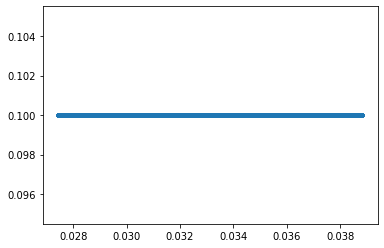

In [9]:
plt.plot(Qout[::10],Sout[::10],'.')

0.156


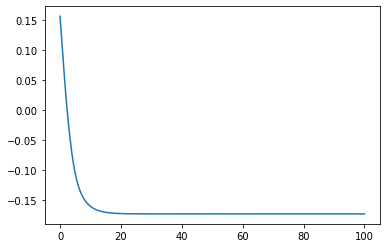

In [10]:
plt.plot(t,Nout)
print(Nout[0])

In [11]:
(Q[1] - Q[0])/dx

0.09999999999990425

In [12]:
S[0]


0.1

In [13]:
N = Ntop + x*(Nbottom-Ntop)/X #+ 0.2*np.sin(x*np.pi);


PSI = (psi + (N[1:] - N[:-1])/dx)   # on the stag grid
Q = np.sign(PSI)*np.sqrt(S**(8/3)*np.abs(PSI))    # on the stag grid


## phi   - porosity of the glacier (non-dimensional, but phi0 = 1)
phi = 5

## pre-allocate output arrays
Qout = t*np.nan
Sout = t*np.nan
Nout = t*np.nan
    
Qout[0] = Q[HalfLx]
Sout[0] = S[HalfLx]
Nout[0] = N[HalfLx]

In [14]:
Nout[0]

0.156

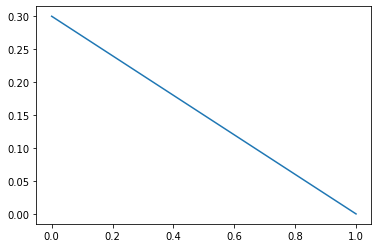

In [15]:
plt.plot(x,N)

In [16]:
N[HalfLx]

0.156

In [17]:
HalfLx


12